In [2]:
import numpy as np
import sdeint
import matplotlib.pyplot as plt
import plotly.express as px
import pycatch22 as catch22
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import pandas as pd
import pickle

In [15]:
np.random.seed(42)
num_samples = 10000
eta_val = list()
sols_list = list()
mu_val = list()
dt = 0.01
tspan = np.arange(0,55, dt)
for i in range(num_samples):
    if (i+1)%1000 == 0:
        print(f'{i+1}/{num_samples}')
    eta = np.random.uniform(0.01, 0.7)
    mu = np.random.uniform(-1.02, -0.98)
    mu_val.append(mu)
    eta_val.append(eta)
    def f(state, t):
        x = state[0]
        dxdt = mu*x
        return dxdt
    ic = np.array([np.random.uniform()])
    gw = lambda y, t: eta * np.identity(ic.shape[0])
    fw = lambda y, t: np.array(f(y,t))
    sol = sdeint.itoint(fw, gw, np.array([ic]), tspan)
    sols_list.append(sol[500:]) # cut out first 500 time points

1000/10000
2000/10000
3000/10000
4000/10000
5000/10000
6000/10000
7000/10000
8000/10000
9000/10000
10000/10000


In [16]:
TS = np.array([sols_list[i][:,0] for i in range(len(sols_list))]) # extract x component
FEATURES_HOOKES = np.array([catch22.catch22_all(TS[i,:])['values'] for i in range(len(sols_list))])
hookes_eta = eta_val
hookes_mu = mu_val

In [17]:
hookes_params = np.vstack([hookes_mu, hookes_eta])

In [18]:
#with open('hookes_FE.pkl', 'wb') as f:
#    pickle.dump(FEATURES_HOOKES, f)
#with open('hookes_TS.pkl', 'wb') as f:
#    pickle.dump(TS, f)
#with open('hookes_params.pkl', 'wb') as f:
#    pickle.dump(hookes_params, f)

In [297]:
with open('hookes_FE.pkl', 'rb') as f:
    hookes_FE = pickle.load(f)
with open('hookes_params.pkl', 'rb') as f:
    hookes_params = pickle.load(f)

In [696]:
with open('bistable_FE.pkl', 'rb') as f:
    bistable_FE = pickle.load(f)
with open('hopfXY_FE.pkl', 'rb') as f:
    hopfXY_FE = pickle.load(f)
with open('bistable_params.pkl', 'rb') as f:
    bistable_params = pickle.load(f)
with open('hopfXY_params.pkl', 'rb') as f:
    hopf_params = pickle.load(f)

In [697]:
FEATURES = np.vstack([hookes_FE, bistable_FE, hopfXY_FE])
normalized_features = StandardScaler().fit_transform(FEATURES)
pca_reducer = PCA(n_components=2)
embedding = pca_reducer.fit_transform(normalized_features)

In [698]:
PC1_components = pca_reducer.components_[0]
PC2_components = pca_reducer.components_[1]
PC1_components

array([-0.00861338, -0.01022256,  0.21333213,  0.2253479 ,  0.32738611,
        0.00083461, -0.31605548,  0.22385423,  0.11276266,  0.20184612,
        0.25285125,  0.00951393,  0.20457681, -0.03643013,  0.01993785,
        0.32169384,  0.12492528, -0.33433405,  0.14034059,  0.17054342,
       -0.29299334, -0.34610527])

In [694]:
PC2_components

array([-0.0210046 , -0.02266017,  0.40946271,  0.3443707 , -0.12856284,
       -0.00074872,  0.13482056,  0.37651226,  0.37611777,  0.11312586,
       -0.20721058,  0.00160769, -0.30415483, -0.11343866,  0.08866672,
        0.00419419, -0.22289312,  0.11253406, -0.35112613, -0.16996986,
       -0.10305854,  0.02688967])

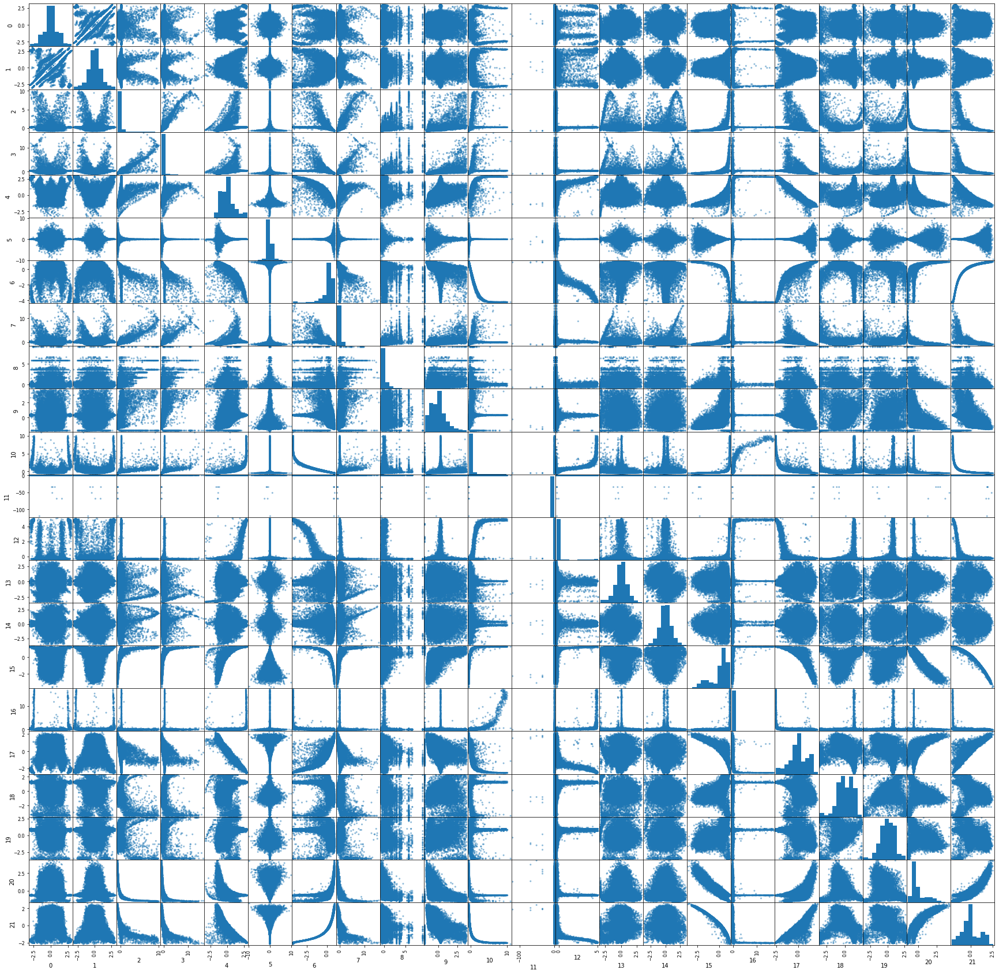

In [684]:
inspect_features = pd.DataFrame(normalized_features)
pd.plotting.scatter_matrix(inspect_features, figsize=(30,30), grid=True)
plt.show()

In [699]:
df_hookes = pd.DataFrame(embedding[:10000])
df_hookes['mu'] = hookes_mu
df_hookes['eta'] = hookes_eta
df_hookes['system'] = "Hookes"

In [700]:
df_bistable = pd.DataFrame(embedding[10000:20000])
df_bistable['mu'] = bistable_params[0, :]
df_bistable['eta'] = bistable_params[1, :]
df_bistable['system'] = 'Bistable'
df_hopf = pd.DataFrame(embedding[20000:])
df_hopf['mu'] = hopf_params[0, :]
df_hopf['eta'] = hopf_params[1, :]
df_hopf['system'] = 'Hopf'
df = pd.concat([df_hookes,df_bistable, df_hopf]) 

In [701]:
rescaled_marker = df['eta'].to_numpy()
rescaled_marker = rescaled_marker/np.max(rescaled_marker) 

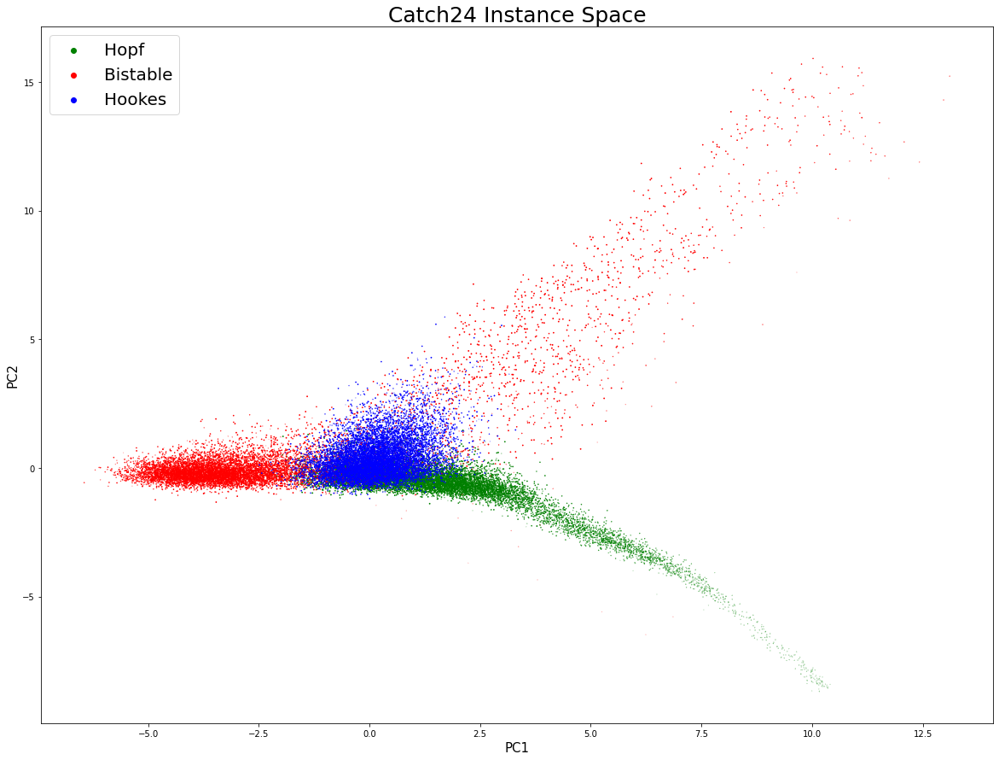

In [702]:
plt.figure(figsize=(20,15))
plt.scatter(df[df['system'] == 'Hopf'][0], df[df['system'] == 'Hopf'][1], s=df[df['system'] == 'Hopf']['eta'], label='Hopf', c='g')
plt.scatter(df[df['system'] == 'Bistable'][0], df[df['system'] == 'Bistable'][1],s =df[df['system'] == 'Bistable']['eta'],label='Bistable', c='r')
plt.scatter(df[df['system'] == 'Hookes'][0], df[df['system'] == 'Hookes'][1], s=df[df['system'] == 'Hookes']['eta'], label='Hookes', c='b')
plt.legend(fontsize=20, markerscale=10.)
plt.xlabel('PC1', fontsize=15)
plt.ylabel('PC2', fontsize=15)
plt.title('Catch24 Instance Space', fontsize=25)
plt.show()

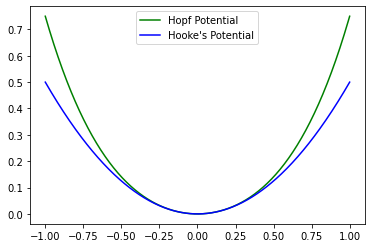

In [304]:
x = np.linspace(-1, 1, 500)
mu = -1
plt.plot(x, -mu*((x**2)/2 + (x**4)/4), color="g", label="Hopf Potential")
k = 1
plt.plot(x, k*x**2/2, color="b", label="Hooke's Potential")
plt.legend()
plt.show()

So a simple Hooke's potential will give qualitatively similar dynamics to a fixed point in a Hopf system and the overlap will be even greater for increasingly negative mu. 

In [703]:
symbols = ['circle', 'cross', 'square']
fig = px.scatter(df, x=0, y=1, color=df["mu"], template="plotly_dark",
    labels={'0': 'PC1', '1': 'PC2', 'color': r"$\lambda$"}, width=1200, height=800, symbol = df["system"],symbol_sequence=symbols, custom_data=['mu', 'eta', 'system', df.index], color_continuous_scale='Jet')
fig.update_traces(
    hovertemplate="<br>".join([
        "Mu: %{customdata[0]:.3f}",
        "Eta: %{customdata[1]:.3f}",
        "System: %{customdata[2]}",
        "TS Index: %{customdata[3]}"
    ])
)
fig.update_layout(
    legend=dict(
        x=0,
        y=1,
        traceorder="reversed",
        font=dict(
            family="Courier",
            size=12,
            color="black"
        ),
        bgcolor="White",
        bordercolor="Black",
        borderwidth=2,
        itemsizing = "constant"
    ))
fig.update_traces(marker=dict(size=3))
fig.update_layout(title_text='Catch22 Instance Space, PCA', title_x=0.5)

fig.show()

## Robust PCA
(Using L1 norm minimisation/Lasso Regression)

In [784]:
from r_pca import R_pca

In [792]:
FEATURES = np.vstack([hookes_FE, bistable_FE, hopfXY_FE])
normalized_features = StandardScaler().fit_transform(FEATURES)
rpca = R_pca(normalized_features)
L, S = rpca.fit(max_iter=20000, iter_print=1000)

iteration: 1, error: 0.3959855922171809
iteration: 1000, error: 0.0014740817113374793
iteration: 2000, error: 0.0010258550018190087
iteration: 3000, error: 0.000420095534486153
iteration: 4000, error: 0.0004964864230302617
iteration: 5000, error: 0.00013644909354297918
iteration: 6000, error: 0.000124384212842609
iteration: 6142, error: 7.80748485325848e-05


In [787]:
def pca(data, numComponents=None):
    """Principal Components Analysis

    From: http://stackoverflow.com/a/13224592/834250

    Parameters
    ----------
    data : `numpy.ndarray`
        numpy array of data to analyse
    numComponents : `int`
        number of principal components to use

    Returns
    -------
    comps : `numpy.ndarray`
        Principal components
    evals : `numpy.ndarray`
        Eigenvalues
    evecs : `numpy.ndarray`
        Eigenvectors
    """
    m, n = data.shape
    data -= data.mean(axis=0)
    R = np.cov(data, rowvar=False)
    # use 'eigh' rather than 'eig' since R is symmetric,
    # the performance gain is substantial
    evals, evecs = np.linalg.eigh(R)
    idx = np.argsort(evals)[::-1]
    evecs = evecs[:,idx]
    evals = evals[idx]
    if numComponents is not None:
        evecs = evecs[:, :numComponents]
    # carry out the transformation on the data using eigenvectors
    # and return the re-scaled data, eigenvalues, and eigenvectors
    return np.dot(evecs.T, data.T).T, evals, evecs

In [793]:
rcomp, revals, revecs = pca(L, 2)

In [794]:
embedding = rcomp

In [795]:
df_hookes = pd.DataFrame(embedding[:10000])
df_hookes['mu'] = hookes_mu
df_hookes['eta'] = hookes_eta
df_hookes['system'] = "Hookes"
df_bistable = pd.DataFrame(embedding[10000:20000])
df_bistable['mu'] = bistable_params[0, :]
df_bistable['eta'] = bistable_params[1, :]
df_bistable['system'] = 'Bistable'
df_hopf = pd.DataFrame(embedding[20000:])
df_hopf['mu'] = hopf_params[0, :]
df_hopf['eta'] = hopf_params[1, :]
df_hopf['system'] = 'Hopf'
df = pd.concat([df_hookes,df_bistable, df_hopf]) 

In [797]:
symbols = ['circle', 'cross', 'square']
fig = px.scatter(df, x=0, y=1, color=df["mu"], template="plotly_dark", size="eta",
    labels={'0': 'PC1', '1': 'PC2', 'color': r"$\lambda$"}, width=1200, height=800, symbol = df["system"],symbol_sequence=symbols, custom_data=['mu', 'eta', 'system', df.index], color_continuous_scale='Jet')
fig.update_traces(
    hovertemplate="<br>".join([
        "Mu: %{customdata[0]:.3f}",
        "Eta: %{customdata[1]:.3f}",
        "System: %{customdata[2]}",
        "TS Index: %{customdata[3]}"
    ])
)
fig.update_layout(
    legend=dict(
        title = "System",
        x=0,
        y=1,
        traceorder="reversed",
        font=dict(
            family="Open Sans",
            size=12,
            color="black"
        ),
        bgcolor="White",
        bordercolor="Black",
        borderwidth=2,
        itemsizing = "constant"
    ))
fig.update_traces(marker=dict(size=3))
fig.update_layout(title_text='Catch22 Instance Space, RPCA', title_x=0.5)

fig.show()

In [354]:
with open('bistable_TS.pkl', 'rb') as f:
    TS_bistable_explore = pickle.load(f)
with open('hopfXY_TS.pkl', 'rb') as f:
    TS_hopf_explore = pickle.load(f)
with open('hookes_TS.pkl', 'rb') as f:
    TS_hookes_explore = pickle.load(f)

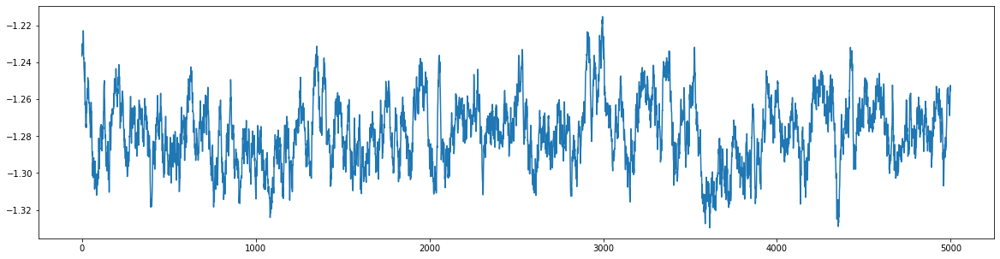

In [798]:
plt.figure(figsize=(20,5))
plt.plot(TS_bistable_explore[7729])

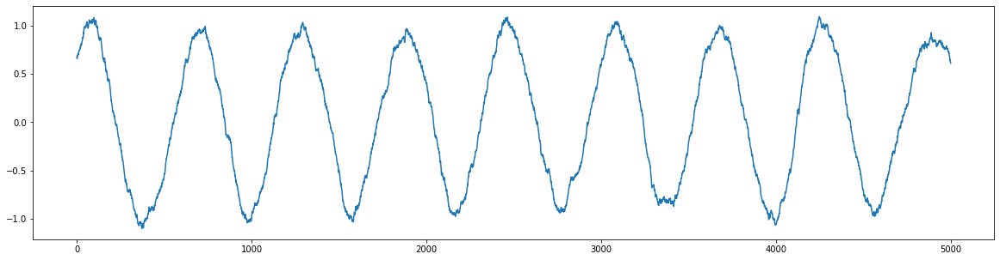

In [799]:
plt.figure(figsize=(20,5))
plt.plot(TS_hopf_explore[2001])


In [636]:
from umap import UMAP
from sklearn.manifold import TSNE

In [568]:
FEATURES = np.vstack([hookes_FE, bistable_FE, hopfXY_FE])
normalized_features = StandardScaler().fit_transform(FEATURES)

In [633]:
umap_reducer = UMAP(random_state=42, n_neighbors=25)
embedding = umap_reducer.fit_transform(normalized_features)

In [634]:
df_hookes = pd.DataFrame(embedding[:10000])
df_hookes['mu'] = hookes_mu
df_hookes['eta'] = hookes_eta
df_hookes['system'] = "Hookes"
df_bistable = pd.DataFrame(embedding[10000:20000])
df_bistable['mu'] = bistable_params[0, :]
df_bistable['eta'] = bistable_params[1, :]
df_bistable['system'] = 'Bistable'
df_hopf = pd.DataFrame(embedding[20000:])
df_hopf['mu'] = hopf_params[0, :]
df_hopf['eta'] = hopf_params[1, :]
df_hopf['system'] = 'Hopf'
df = pd.concat([df_hookes,df_bistable, df_hopf]) 

In [635]:
symbols = ['circle', 'cross', 'square']
fig = px.scatter(df, x=0, y=1, color=df["mu"], template="plotly_dark",
    labels={'0': 'PC1', '1': 'PC2', 'color': r"$\lambda$"}, width=1200, height=800, symbol = df["system"],symbol_sequence=symbols, custom_data=['mu', 'eta', 'system', df.index], color_continuous_scale='Jet')
fig.update_traces(
    hovertemplate="<br>".join([
        "Mu: %{customdata[0]:.3f}",
        "Eta: %{customdata[1]:.3f}",
        "System: %{customdata[2]}",
        "TS Index: %{customdata[3]}"
    ])
)
fig.update_layout(
    legend=dict(
        x=0,
        y=1,
        traceorder="reversed",
        font=dict(
            family="Courier",
            size=12,
            color="black"
        ),
        bgcolor="White",
        bordercolor="Black",
        borderwidth=2,
        itemsizing = "constant"
    ))
fig.update_traces(marker=dict(size=3))
fig.update_layout(title_text='Catch22 Instance Space, UMAP', title_x=0.5)

fig.show()

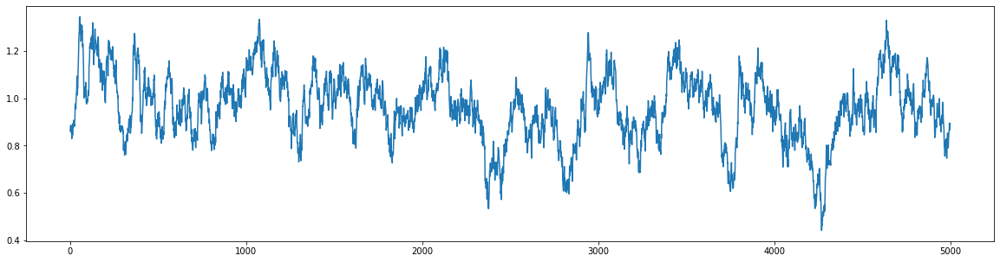

In [604]:
plt.figure(figsize=(20,5))
plt.plot(TS_bistable_explore[3689])

In [637]:
FEATURES = np.vstack([hookes_FE, bistable_FE, hopfXY_FE])
normalized_features = StandardScaler().fit_transform(FEATURES)

In [801]:
tsne_reducer = TSNE(perplexity=1000, n_iter=1000, random_state=0)
embedding = tsne_reducer.fit_transform(normalized_features)

/Users/joshua/opt/anaconda3/envs/pysindy/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/Users/joshua/opt/anaconda3/envs/pysindy/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



KeyboardInterrupt: 

In [649]:
df_hookes = pd.DataFrame(embedding[:10000])
df_hookes['mu'] = hookes_mu
df_hookes['eta'] = hookes_eta
df_hookes['system'] = "Hookes"
df_bistable = pd.DataFrame(embedding[10000:20000])
df_bistable['mu'] = bistable_params[0, :]
df_bistable['eta'] = bistable_params[1, :]
df_bistable['system'] = 'Bistable'
df_hopf = pd.DataFrame(embedding[20000:])
df_hopf['mu'] = hopf_params[0, :]
df_hopf['eta'] = hopf_params[1, :]
df_hopf['system'] = 'Hopf'
df = pd.concat([df_hookes,df_bistable, df_hopf]) 

In [650]:
symbols = ['circle', 'cross', 'square']
fig = px.scatter(df, x=0, y=1, color=df["mu"], template="plotly_dark",
    labels={'0': 'PC1', '1': 'PC2', 'color': r"$\lambda$"}, width=1200, height=800, symbol = df["system"],symbol_sequence=symbols, custom_data=['mu', 'eta', 'system', df.index], color_continuous_scale='Jet')
fig.update_traces(
    hovertemplate="<br>".join([
        "Mu: %{customdata[0]:.3f}",
        "Eta: %{customdata[1]:.3f}",
        "System: %{customdata[2]}",
        "TS Index: %{customdata[3]}"
    ])
)
fig.update_layout(
    legend=dict(
        x=0,
        y=1,
        traceorder="reversed",
        font=dict(
            family="Courier",
            size=12,
            color="black"
        ),
        bgcolor="White",
        bordercolor="Black",
        borderwidth=2,
        itemsizing = "constant"
    ))
fig.update_traces(marker=dict(size=3))
fig.update_layout(title_text='Catch22 Instance Space, t-SNE', title_x=0.5)

fig.show()

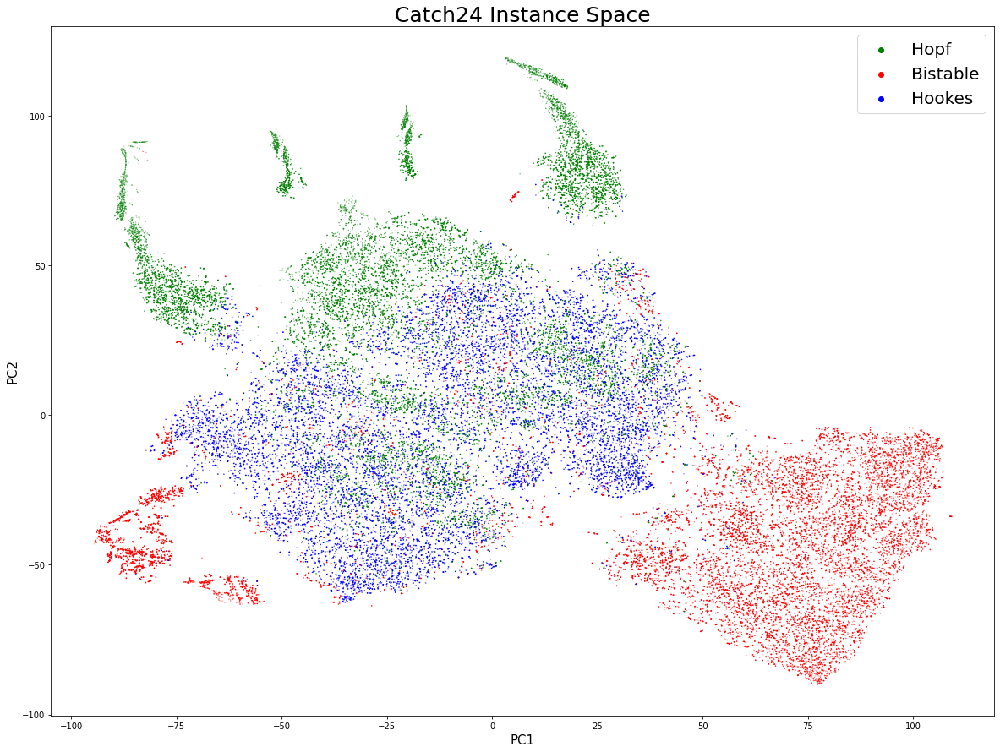

In [651]:
plt.figure(figsize=(20,15))
plt.scatter(df[df['system'] == 'Hopf'][0], df[df['system'] == 'Hopf'][1], s=df[df['system'] == 'Hopf']['eta'], label='Hopf', c='g')
plt.scatter(df[df['system'] == 'Bistable'][0], df[df['system'] == 'Bistable'][1],s =df[df['system'] == 'Bistable']['eta'],label='Bistable', c='r')
plt.scatter(df[df['system'] == 'Hookes'][0], df[df['system'] == 'Hookes'][1], s=df[df['system'] == 'Hookes']['eta'], label='Hookes', c='b')
plt.legend(fontsize=20, markerscale=10.)
plt.xlabel('PC1', fontsize=15)
plt.ylabel('PC2', fontsize=15)
plt.title('Catch24 Instance Space', fontsize=25)
plt.show()

In [759]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.decomposition import SparsePCA

In [764]:
FEATURES = np.vstack([hookes_FE, bistable_FE, hopfXY_FE])
scaled_features = StandardScaler().fit_transform(FEATURES)
pca_reducer = SparsePCA(n_components=2)
embedding = pca_reducer.fit_transform(scaled_features)

In [766]:
df_hookes = pd.DataFrame(embedding[:10000])
df_hookes['mu'] = hookes_mu
df_hookes['eta'] = hookes_eta
df_hookes['system'] = "Hookes"
df_bistable = pd.DataFrame(embedding[10000:20000])
df_bistable['mu'] = bistable_params[0, :]
df_bistable['eta'] = bistable_params[1, :]
df_bistable['system'] = 'Bistable'
df_hopf = pd.DataFrame(embedding[20000:])
df_hopf['mu'] = hopf_params[0, :]
df_hopf['eta'] = hopf_params[1, :]
df_hopf['system'] = 'Hopf'
df = pd.concat([df_hookes,df_bistable, df_hopf]) 

In [767]:
symbols = ['circle', 'cross', 'square']
fig = px.scatter(df, x=0, y=1, color=df["mu"], template="plotly_dark",
    labels={'0': 'PC1', '1': 'PC2', 'color': r"$\lambda$"}, width=1200, height=800, symbol = df["system"],symbol_sequence=symbols, custom_data=['mu', 'eta', 'system', df.index], color_continuous_scale='Jet')
fig.update_traces(
    hovertemplate="<br>".join([
        "Mu: %{customdata[0]:.3f}",
        "Eta: %{customdata[1]:.3f}",
        "System: %{customdata[2]}",
        "TS Index: %{customdata[3]}"
    ])
)
fig.update_layout(
    legend=dict(
        x=0,
        y=1,
        traceorder="reversed",
        font=dict(
            family="Courier",
            size=12,
            color="black"
        ),
        bgcolor="White",
        bordercolor="Black",
        borderwidth=2,
        itemsizing = "constant"
    ))
fig.update_traces(marker=dict(size=3))
fig.update_layout(title_text='Catch22 Instance Space, t-SNE', title_x=0.5)

fig.show()

In [811]:
from sklearn.neighbors import KernelDensity

In [812]:
X = np.array([[-1, -1], [-2, -1], [-3, -2], [1, 1], [2, 1], [3, 2]])

In [813]:
kde = KernelDensity(kernel='gaussian', bandwidth=0.2).fit(X)

In [815]:
kde.score_samples(X)

array([-0.41075698, -0.41075698, -0.41076071, -0.41075698, -0.41075698,
       -0.41076071])

In [826]:
np.random.seed(0)
num_samples = 10000 # 49 mins
eta_val_bist = np.random.uniform(0.01, 0.8, size=num_samples)
mu_val_bist = np.random.uniform(-2, 2, size=num_samples)
sols_list = list()
dt = 0.01
tspan = np.arange(0, 55, dt)
for i in range(num_samples):
    if (i+1)%100 == 0:
        print(f'{i+1}/{num_samples}')
    mu = mu_val_bist[i] # uniform random mu value
    eta = eta_val_bist[i] # uniform random eta value
    def f(state, t):
        x = state
        dxdt = mu + x - x**3
        return dxdt 
    ic = np.array([np.random.uniform()]) # uniform random initial conditions
    gw = lambda y, t: eta * np.identity(ic.shape[0]) # noise is relative to ic's 
    fw = lambda y, t: np.array(f(y,t))
    sol = sdeint.itoint(fw, gw, np.array(ic), tspan)
    sols_list.append(sol[500:]) # cut out first 500 time points

100/10000
200/10000
300/10000
400/10000
500/10000
600/10000
700/10000
800/10000
900/10000
1000/10000
1100/10000
1200/10000
1300/10000
1400/10000
1500/10000
1600/10000
1700/10000
1800/10000
1900/10000
2000/10000
2100/10000
2200/10000
2300/10000
2400/10000
2500/10000
2600/10000
2700/10000
2800/10000
2900/10000
3000/10000
3100/10000
3200/10000
3300/10000
3400/10000
3500/10000
3600/10000
3700/10000
3800/10000
3900/10000
4000/10000
4100/10000
4200/10000
4300/10000
4400/10000
4500/10000
4600/10000
4700/10000
4800/10000
4900/10000
5000/10000
5100/10000
5200/10000
5300/10000
5400/10000
5500/10000
5600/10000
5700/10000
5800/10000
5900/10000
6000/10000
6100/10000
6200/10000
6300/10000
6400/10000
6500/10000
6600/10000
6700/10000
6800/10000
6900/10000
7000/10000
7100/10000
7200/10000
7300/10000
7400/10000
7500/10000
7600/10000
7700/10000
7800/10000
7900/10000
8000/10000
8100/10000
8200/10000
8300/10000
8400/10000
8500/10000
8600/10000
8700/10000
8800/10000
8900/10000
9000/10000
9100/10000
9200/100

In [822]:
sols_record = np.array([sols_list[i][:,0] for i in range(len(sols_list))])
df_bist = pd.DataFrame(sols_record)
df_bist["mu"] = mu_val_bist
df_bist["eta"] = eta_val_bist
df_bist.to_pickle("bist.pkl")

In [3]:
np.random.seed(42)
num_samples = 10
eta_val = list()
sols_list = list()
mu_val = list()
dt = 0.01
tspan = np.arange(0,55, dt)
for i in range(num_samples):
    if (i+1)%1000 == 0:
        print(f'{i+1}/{num_samples}')
    eta = np.random.uniform(0.01, 0.7)
    mu = np.random.uniform(-1.1, -0.9)
    mu_val.append(mu)
    eta_val.append(eta)
    def f(state, t):
        x = state[0]
        dxdt = mu*x**3
        return dxdt
    ic = np.array([np.random.uniform()])
    gw = lambda y, t: eta * np.identity(ic.shape[0])
    fw = lambda y, t: np.array(f(y,t))
    sol = sdeint.itoint(fw, gw, np.array([ic]), tspan)
    sols_list.append(sol[500:]) # cut out first 500 time points

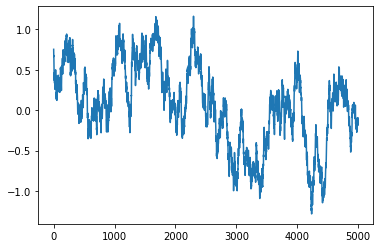

In [14]:
plt.plot(sols_list[7])